#Deteksi Potongan Tubuh Korban Bencana Alam
##Faster R-CNN Inception ResNet V2 640x640

##1. Starter

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/InceptionV2

In [ ]:
#delete files

import shutil

# remove old account directory
shutil.rmtree(r'/content/drive/MyDrive/InceptionV2/1000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8')
#shutil.rmtree(r'/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8')

##2. GPU Check

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Thu Jan 19 14:20:11 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   56C    P0    27W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

##3. Import Required Files

In [2]:
%cd /content/drive/MyDrive/

import tensorflow as tf

tf.__version__

/content/drive/MyDrive


'2.11.0'

In [3]:
#Reset all runtime 
import os
os.environ['DISABLE_COLAB_TF_IMPORT_HOOK'] = '1'

##4. Split Dataset

###UnZip

####Dataset100

In [ ]:
#Unzip dataset

%cd /content/drive/MyDrive/FasterRCNN101/dataset100
!unzip dataset.zip

/content/drive/MyDrive/FasterRCNN101/dataset100
Archive:  dataset.zip
  inflating: body (1).jpg            
  inflating: body (1).xml            
  inflating: body (2).jpg            
  inflating: body (2).xml            
  inflating: body (3).jpg            
  inflating: body (3).xml            
  inflating: body (4).jpg            
  inflating: body (4).xml            
  inflating: body (5).jpg            
  inflating: body (5).xml            
  inflating: body (6).jpg            
  inflating: body (6).xml            
  inflating: body (7).jpg            
  inflating: body (7).xml            
  inflating: body (8).jpg            
  inflating: body (8).xml            
  inflating: body (9).jpg            
  inflating: body (9).xml            
  inflating: body (10).jpg           
  inflating: body (10).xml           
  inflating: foot (1).jpg            
  inflating: foot (1).xml            
  inflating: foot (2).jpg            
  inflating: foot (2).xml            
  inflating: foot 

####Dataset150

In [ ]:
#Unzip dataset

%cd /content/drive/MyDrive/FasterRCNN50/dataset150
!unzip dataset.zip

###ImageCheck

In [ ]:
from pathlib import Path
import imghdr

data_dir = "/content/drive/MyDrive/FasterRCNN101/dataset100"
image_extensions = [".png", ".jpg"]  # add there all your images file extensions

img_type_accepted_by_tf = ["bmp", "gif", "jpeg", "png"]
for filepath in Path(data_dir).rglob("*"):
    if filepath.suffix.lower() in image_extensions:
        img_type = imghdr.what(filepath)
        if img_type is None:
            print(f"{filepath} is not an image")
        elif img_type not in img_type_accepted_by_tf:
            print(f"{filepath} is a {img_type}, not accepted by TensorFlow")

###Membagi Images

####_Percobaan01

In [ ]:
#Membagi dataset 80% train 20% test step 3000

%cd /content/drive/MyDrive/FasterRCNN101

!python partition_dataset.py --imageDir /content/drive/MyDrive/FasterRCNN101/dataset100 --outputDir /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images --ratio 0.2 --xml

/content/drive/MyDrive/FasterRCNN101


##5. Convert XML to CSV

###1000 Steps

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images

!python converter.py

/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images
Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


In [ ]:
#Pindah hasil convert ke foder annotations

import shutil

pbtxt = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/label_map.pbtxt'
train_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train_labels.csv'
test_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test_labels.csv'
target = r'/content/drive/MyDrive/InceptionV2/1000/annotations'

shutil.move(pbtxt, target)
shutil.move(train_labels, target)
shutil.move(test_labels, target)

'/content/drive/MyDrive/InceptionV2/1000/annotations/test_labels.csv'

###2000 Steps

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images

!python converter.py

/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images
Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


In [ ]:
#Pindah hasil convert ke foder annotations

import shutil

pbtxt = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/label_map.pbtxt'
train_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train_labels.csv'
test_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test_labels.csv'
target = r'/content/drive/MyDrive/InceptionV2/2000/annotations'

shutil.move(pbtxt, target)
shutil.move(train_labels, target)
shutil.move(test_labels, target)

'/content/drive/MyDrive/InceptionV2/2000/annotations/test_labels.csv'

###3000 Steps

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images

!python converter.py

/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images
Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


In [ ]:
#Pindah hasil convert ke foder annotations

import shutil

pbtxt = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/label_map.pbtxt'
train_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train_labels.csv'
test_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test_labels.csv'
target = r'/content/drive/MyDrive/InceptionV2/3000/annotations'

shutil.move(pbtxt, target)
shutil.move(train_labels, target)
shutil.move(test_labels, target)

'/content/drive/MyDrive/InceptionV2/3000/annotations/test_labels.csv'

###4000 Step

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images

!python converter.py

/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images
Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


In [ ]:
#Pindah hasil convert ke foder annotations

import shutil

pbtxt = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/label_map.pbtxt'
train_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train_labels.csv'
test_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test_labels.csv'
target = r'/content/drive/MyDrive/InceptionV2/4000/annotations'

shutil.move(pbtxt, target)
shutil.move(train_labels, target)
shutil.move(test_labels, target)

'/content/drive/MyDrive/InceptionV2/4000/annotations/test_labels.csv'

###5000

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images

!python converter.py

/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images
Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


In [ ]:
#Pindah hasil convert ke foder annotations

import shutil

pbtxt = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/label_map.pbtxt'
train_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train_labels.csv'
test_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test_labels.csv'
target = r'/content/drive/MyDrive/InceptionV2/5000/annotations'

shutil.move(pbtxt, target)
shutil.move(train_labels, target)
shutil.move(test_labels, target)

'/content/drive/MyDrive/InceptionV2/5000/annotations/test_labels.csv'

###7000

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images

!python converter.py

/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images
Successfully converted train_labels xml to csv.
Successfully converted test_labels xml to csv.
Successfully created label_map.pbtxt 


In [ ]:
#Pindah hasil convert ke foder annotations

import shutil

pbtxt = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/label_map.pbtxt'
train_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train_labels.csv'
test_labels = r'/content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test_labels.csv'
target = r'/content/drive/MyDrive/InceptionV2/7000/annotations'

shutil.move(pbtxt, target)
shutil.move(train_labels, target)
shutil.move(test_labels, target)

'/content/drive/MyDrive/InceptionV2/7000/annotations/test_labels.csv'

##6. Cloning TFOD 2.0 Github

In [ ]:
%cd /content/drive/MyDrive/
!git clone --quiet https://github.com/tensorflow/models.git

/content/drive/MyDrive/FasterRCNN50


In [ ]:
%cd /content/drive/MyDrive/models/research
!protoc object_detection/protos/*.proto --python_out=.

/content/drive/MyDrive/FasterRCNN50/models/research


In [ ]:
!git clone https://github.com/cocodataset/cocoapi.git

Cloning into 'cocoapi'...
remote: Enumerating objects: 975, done.
remote: Total 975 (delta 0), reused 0 (delta 0), pack-reused 975
Receiving objects: 100% (975/975), 11.72 MiB | 15.57 MiB/s, done.
Resolving deltas: 100% (576/576), done.


In [ ]:
%cd /content/drive/MyDrive/models/research/cocoapi/PythonAPI

!make

/content/drive/MyDrive/FasterRCNN50/models/research/cocoapi/PythonAPI
python setup.py build_ext --inplace
running build_ext
cythoning pycocotools/_mask.pyx to pycocotools/_mask.c
/usr/local/lib/python3.8/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/drive/MyDrive/FasterRCNN50/models/research/cocoapi/PythonAPI/pycocotools/_mask.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.8
creating build/temp.linux-x86_64-3.8/pycocotools
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -g -fwrapv -O2 -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/lib/python3.8/dist-packages/numpy/core/in

In [ ]:
cp -r pycocotools /content/drive/models/research

##7. Install the Object Detection API **

In [4]:
%cd /content/drive/MyDrive/models/research

/content/drive/MyDrive/models/research


In [5]:
cp object_detection/packages/tf2/setup.py .

In [6]:
!python -m pip install . --use-feature=in-tree-build

DEPRECATION: In-tree builds are now the default. pip 22.1 will enforce this behaviour change. A possible replacement is to remove the --use-feature=in-tree-build flag.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/drive/MyDrive/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.5/14.5 MB 69.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 81.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 44.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 KB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 82.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 KB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done

In [7]:
#From within TensorFlow/models/research/
!python object_detection/builders/model_builder_tf2_test.py

2023-03-28 14:35:26.770540: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-28 14:35:26.770751: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-28 14:35:26.770806: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-03-28 14:35:32.052735: E tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:267] failed call to c

##8. Generate TF Record

###__1000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/1000/annotations

#Using .CSV
#For train.record
!python generate_tfrecord.py train_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train train.record
#For test.record
!python generate_tfrecord.py test_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test test.record

/content/drive/MyDrive/InceptionV2/1000/annotations
2023-01-22 18:17:07.965498: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-22 18:17:07.965588: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-22 18:17:07.965602: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
groups: 100% 80/80 [00:00<00:00, 378.72it/s]
Successfully created the TFRecords: /content/drive/MyDrive/InceptionV2

###__2000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/2000/annotations

#Using .CSV
#For train.record
!python generate_tfrecord.py train_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train train.record
#For test.record
!python generate_tfrecord.py test_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test test.record

/content/drive/MyDrive/InceptionV2/2000/annotations
2023-01-19 17:13:43.798336: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 17:13:43.798425: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 17:13:43.798435: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
groups: 100% 80/80 [00:00<00:00, 308.03it/s]
Successfully created the TFRecords: /content/drive/MyDrive/InceptionV2

###__3000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/3000/annotations

#Using .CSV
#For train.record
!python generate_tfrecord.py train_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train train.record
#For test.record
!python generate_tfrecord.py test_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test test.record

/content/drive/MyDrive/InceptionV2/3000/annotations
2023-03-28 05:03:19.554741: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-28 05:03:19.554851: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-28 05:03:19.554870: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
groups: 100% 160/160 [00:00<00:00, 303.02it/s]
Successfully created the TFRecords: /content/drive/MyDrive/Inception

###__4000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/4000/annotations

#Using .CSV
#For train.record
!python generate_tfrecord.py train_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train train.record
#For test.record
!python generate_tfrecord.py test_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test test.record

/content/drive/MyDrive/InceptionV2/4000/annotations
2023-03-07 13:13:12.223218: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-07 13:13:12.223323: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-07 13:13:12.223341: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
groups: 100% 160/160 [00:00<00:00, 326.38it/s]
Successfully created the TFRecords: /content/drive/MyDrive/Inception

###__5000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/5000/annotations

#Using .CSV
#For train.record
!python generate_tfrecord.py train_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train train.record
#For test.record
!python generate_tfrecord.py test_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test test.record

/content/drive/MyDrive/InceptionV2/5000/annotations
2023-03-08 08:49:33.730285: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-08 08:49:33.730406: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-08 08:49:33.730426: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
groups: 100% 160/160 [00:00<00:00, 319.82it/s]
Successfully created the TFRecords: /content/drive/MyDrive/Inception

###_7000

In [8]:
%cd /content/drive/MyDrive/InceptionV2/7000/annotations

#Using .CSV
#For train.record
!python generate_tfrecord.py train_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/train train.record
#For test.record
!python generate_tfrecord.py test_labels.csv label_map.pbtxt /content/drive/MyDrive/FasterRCNN101/_Percobaan01/images/test test.record

/content/drive/MyDrive/InceptionV2/7000/annotations
2023-03-28 14:36:41.520551: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-28 14:36:41.520711: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-28 14:36:41.520740: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
groups: 100% 160/160 [01:40<00:00,  1.59it/s]
Successfully 

##9. Cloning Object Detection Master

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz

/content/drive/MyDrive/InceptionV2/object_detection_master
--2023-03-07 08:06:05--  http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.197.128, 2607:f8b0:400e:c03::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.197.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 444343592 (424M) [application/x-tar]
Saving to: ‘faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz’

faster_rcnn_incepti 100%[===================>] 423.76M  82.0MB/s    in 5.1s    

2023-03-07 08:06:11 (83.3 MB/s) - ‘faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz’ saved [444343592/444343592]



###_Percobaan01

####__1000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

#Extract master to 1000
!tar -xvf 'faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz' -C '/content/drive/MyDrive/InceptionV2/1000/pre_trained_models'

/content/drive/MyDrive/InceptionV2/object_detection_master
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#Edit parameter pipline.config lalu cloning ke folder trained_model

%cd /content/drive/MyDrive/InceptionV2/1000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8

import shutil

original = r'/content/drive/MyDrive/InceptionV2/1000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'
target = r'/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

shutil.copyfile(original, target)

/content/drive/MyDrive/InceptionV2/1000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8


'/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

####__2000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

#Extract master to 1000
!tar -xvf 'faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz' -C '/content/drive/MyDrive/InceptionV2/2000/pre_trained_models'

/content/drive/MyDrive/InceptionV2/object_detection_master
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#Edit parameter pipline.config lalu cloning ke folder trained_model

%cd /content/drive/MyDrive/InceptionV2/2000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8

import shutil

original = r'/content/drive/MyDrive/InceptionV2/2000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'
target = r'/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

shutil.copyfile(original, target)

/content/drive/MyDrive/InceptionV2/2000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8


'/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

####__3000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

#Extract master to 3000
!tar -xvf 'faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz' -C '/content/drive/MyDrive/InceptionV2/3000/pre_trained_models'

/content/drive/MyDrive/InceptionV2/object_detection_master
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#Edit parameter pipline.config lalu cloning ke folder trained_model

%cd /content/drive/MyDrive/InceptionV2/3000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8

import shutil

original = r'/content/drive/MyDrive/InceptionV2/3000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'
target = r'/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

shutil.copyfile(original, target)

/content/drive/MyDrive/InceptionV2/3000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8


'/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

####__4000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

#Extract master to 4000
!tar -xvf 'faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz' -C '/content/drive/MyDrive/InceptionV2/4000/pre_trained_models'

/content/drive/MyDrive/InceptionV2/object_detection_master
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#Edit parameter pipline.config lalu cloning ke folder trained_model

%cd /content/drive/MyDrive/InceptionV2/4000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8

import shutil

original = r'/content/drive/MyDrive/InceptionV2/4000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'
target = r'/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

shutil.copyfile(original, target)

/content/drive/MyDrive/InceptionV2/4000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8


'/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

####__5000

In [ ]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

#Extract master to 5000
!tar -xvf 'faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz' -C '/content/drive/MyDrive/InceptionV2/5000/pre_trained_models'

/content/drive/MyDrive/InceptionV2/object_detection_master
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#Edit parameter pipline.config lalu cloning ke folder trained_model

%cd /content/drive/MyDrive/InceptionV2/5000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8

import shutil

original = r'/content/drive/MyDrive/InceptionV2/5000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'
target = r'/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

shutil.copyfile(original, target)

/content/drive/MyDrive/InceptionV2/5000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8


'/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

####_7000

In [9]:
%cd /content/drive/MyDrive/InceptionV2/object_detection_master

#Extract master to 7000
!tar -xvf 'faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8.tar.gz' -C '/content/drive/MyDrive/InceptionV2/7000/pre_trained_models'

/content/drive/MyDrive/InceptionV2/object_detection_master
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/checkpoint
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/checkpoint/ckpt-0.index
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/saved_model.pb
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/saved_model/variables/variables.index


In [ ]:
#Edit parameter pipline.config lalu cloning ke folder trained_model

%cd /content/drive/MyDrive/InceptionV2/7000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8

import shutil

original = r'/content/drive/MyDrive/InceptionV2/7000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'
target = r'/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

shutil.copyfile(original, target)

/content/drive/MyDrive/InceptionV2/7000/pre_trained_models/faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8


'/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config'

##10. Training Model

###__1000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-01-22 18:22:15.864713: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-22 18:22:15.864820: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-22 18:22:15.864838: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-01-22 18:22:19.502243: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value

###__2000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-01-19 17:23:57.174878: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 17:23:57.174966: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 17:23:57.174981: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-01-19 17:24:00.800703: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value

###__3000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-03-28 05:06:50.192204: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-28 05:06:50.192303: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-28 05:06:50.192322: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-03-28 05:06:53.836902: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value

###__4000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-03-07 13:22:36.356328: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-07 13:22:36.356448: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-07 13:22:36.356472: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-03-07 13:22:41.357190: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value

###__5000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-03-08 08:55:07.045542: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-08 08:55:07.045639: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-08 08:55:07.045658: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-03-08 08:55:12.636675: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value

###__7000

In [10]:
%cd /content/drive/MyDrive/models/research/object_detection

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-03-28 14:39:52.757223: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-28 14:39:52.757363: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-28 14:39:52.757390: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-03-28 14:39:58.245499: E tensorflow/compiler/xla/s

##11. Evaluation (Precision, Recall)

###__1000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection/

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --checkpoint_dir=/content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-01-22 18:45:27.093408: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-22 18:45:27.093490: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-22 18:45:27.093500: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
W0122 18:45:29.986554 140685336755264 model_lib_v2.py:1089] Forced number of epochs for all eval validations to

###__2000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection/

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --checkpoint_dir=/content/drive/MyDrive/InceptionV2/2000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-01-19 18:07:23.409745: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 18:07:23.409836: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 18:07:23.409846: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
W0119 18:07:26.144109 140508330818624 model_lib_v2.py:1089] Forced number of epochs for all eval validations to

###__3000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection/

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --checkpoint_dir=/content/drive/MyDrive/InceptionV2/3000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --alsologtostderr

###__4000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection/

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --checkpoint_dir=/content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-03-07 14:50:04.939535: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-07 14:50:04.939664: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-07 14:50:04.939684: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
W0307 14:50:09.701942 139652893730624 model_lib_v2.py:1089] Forced number of epochs for all eval validations to

###__5000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection/

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --checkpoint_dir=/content/drive/MyDrive/InceptionV2/5000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --alsologtostderr

/content/drive/MyDrive/models/research/object_detection
2023-03-08 10:45:23.173440: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-08 10:45:23.173566: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-08 10:45:23.173584: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
W0308 10:45:27.687885 140696816432960 model_lib_v2.py:1089] Forced number of epochs for all eval validations to

###__7000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection/

!python model_main_tf2.py --model_dir=/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --pipeline_config_path=/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --checkpoint_dir=/content/drive/MyDrive/InceptionV2/7000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --alsologtostderr

##12. Export Models

###1000


In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path /content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --trained_checkpoint_dir /content/drive/MyDrive/InceptionV2/1000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --output_directory /content/drive/MyDrive/InceptionV2/1000/exported_models/my_models

/content/drive/MyDrive/models/research/object_detection
2023-01-19 17:09:18.346053: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 17:09:18.346150: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-19 17:09:18.346168: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-01-19 17:09:21.640958: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overriding orig_value

###3000

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/models/research/object_detection

!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path /content/drive/MyDrive/FasterRCNN101/_Percobaan01/3000/trained_models/my_faster_rcnn_resnet101_v1_640x640_coco17_tpu-8/pipeline.config --trained_checkpoint_dir /content/drive/MyDrive/FasterRCNN101/_Percobaan01/3000/trained_models/my_faster_rcnn_resnet101_v1_640x640_coco17_tpu-8 --output_directory /content/drive/MyDrive/FasterRCNN101/_Percobaan01/3000/exported_models/my_models

/content/drive/MyDrive/FasterRCNN101/models/research/object_detection
2023-01-16 17:59:06.016205: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-16 17:59:06.016315: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-16 17:59:06.016334: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-01-16 17:59:09.041044: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:42] Overrid

###4000

In [ ]:
%cd /content/drive/MyDrive/models/research/object_detection

!python exporter_main_v2.py --input_type image_tensor --pipeline_config_path /content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8/pipeline.config --trained_checkpoint_dir /content/drive/MyDrive/InceptionV2/4000/trained_models/my_faster_rcnn_inception_resnet_v2_640x640_coco17_tpu-8 --output_directory /content/drive/MyDrive/InceptionV2/4000/exported_models/my_models

/content/drive/MyDrive/models/research/object_detection
2023-01-25 15:18:32.430171: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-25 15:18:33.364851: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-25 15:18:33.364933: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-25 15:18:33.364949: W 

##13. Tensor Board

###Train

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN50/_Percobaan01/3000/trained_models/my_faster_rcnn_resnet50_v1_640x640_coco17_tpu-8
%reload_ext tensorboard
%tensorboard --logdir 'train'

/content/drive/MyDrive/FasterRCNN50/_Percobaan01/3000/trained_models/my_faster_rcnn_resnet50_v1_640x640_coco17_tpu-8


<IPython.core.display.Javascript object>

###Eval

In [ ]:
%cd /content/drive/MyDrive/FasterRCNN50/_Percobaan01/3000/trained_models/my_faster_rcnn_resnet50_v1_640x640_coco17_tpu-8

%load_ext tensorboard
%tensorboard --logdir 'eval'

/content/drive/MyDrive/FasterRCNN50/_Percobaan01/3000/trained_models/my_faster_rcnn_resnet50_v1_640x640_coco17_tpu-8
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

##14. Detection Models

####Step 3000

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (20).jpg to uji (20) (1).jpg
saved file uji (20).jpg
/content/drive/MyDrive/FasterRCNN101/models/research
Loading model...Done! Took 16.08532190322876 seconds
Done


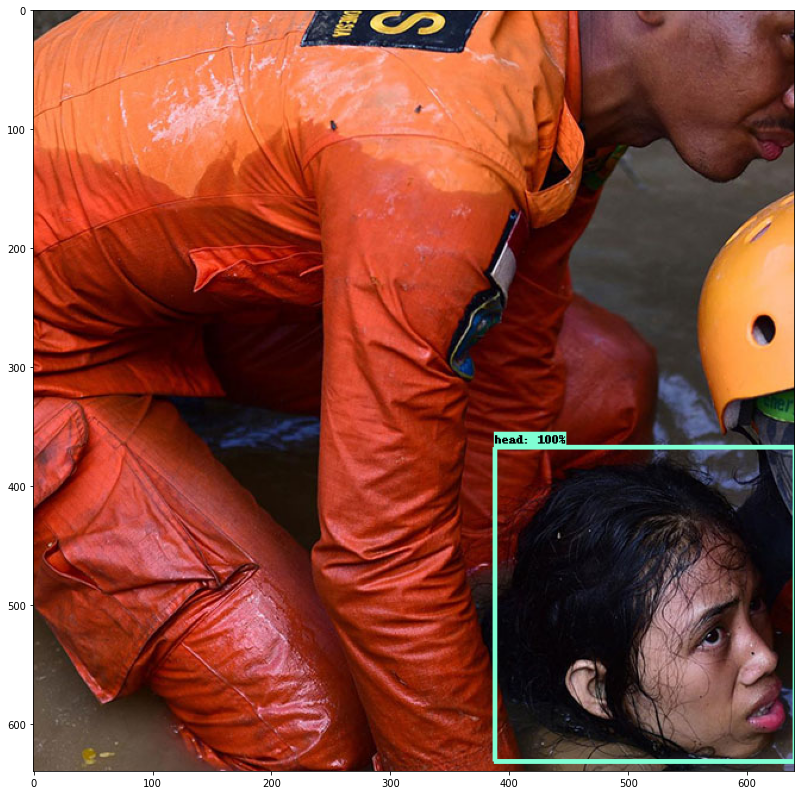

/content/drive/MyDrive/_Artikel/foto_uji_3000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/FasterRCNN101/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.80

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/3000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/3000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (25, 14)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_3000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

####Step 4000

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (4).jpg to uji (4).jpg
saved file uji (4).jpg
/content/drive/MyDrive/models/research
Loading model...Done! Took 12.851041555404663 seconds
Done


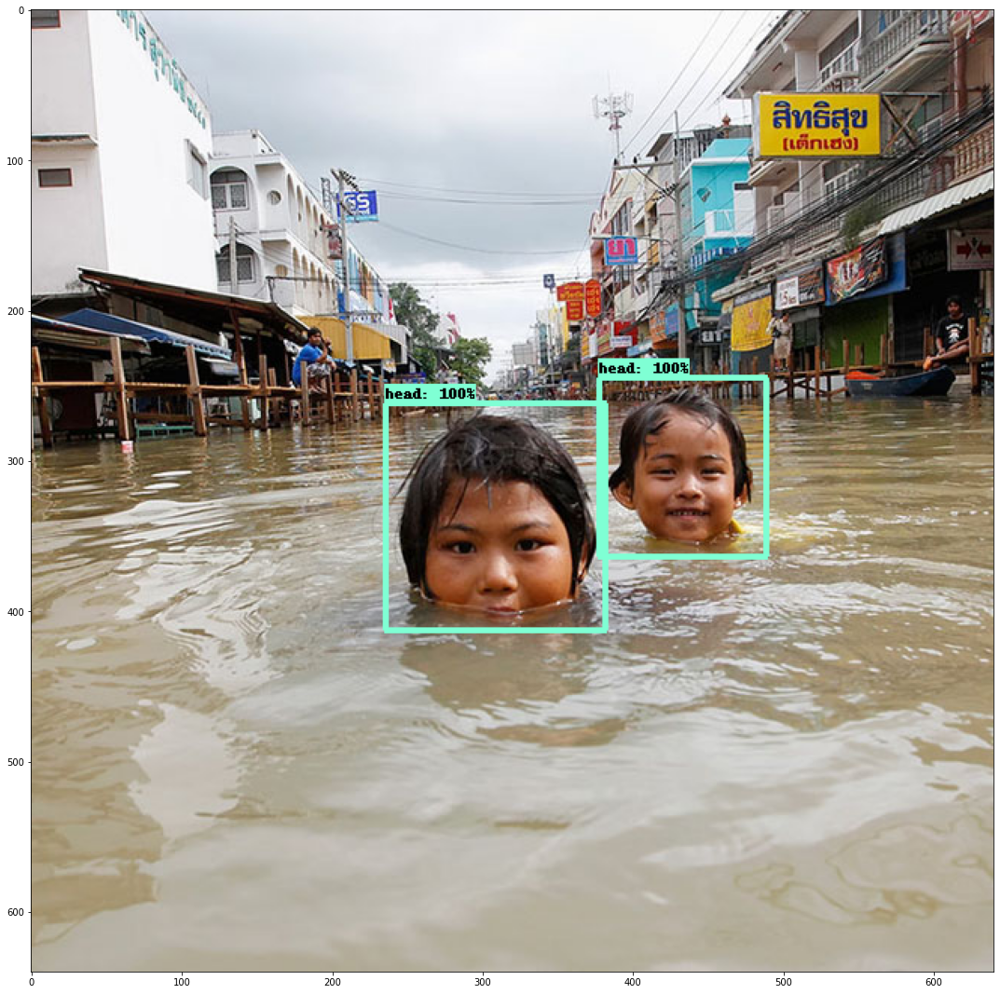

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (5).jpg to uji (5).jpg
saved file uji (5).jpg
/content/drive/MyDrive/models/research
Loading model...Done! Took 13.565962314605713 seconds
Done


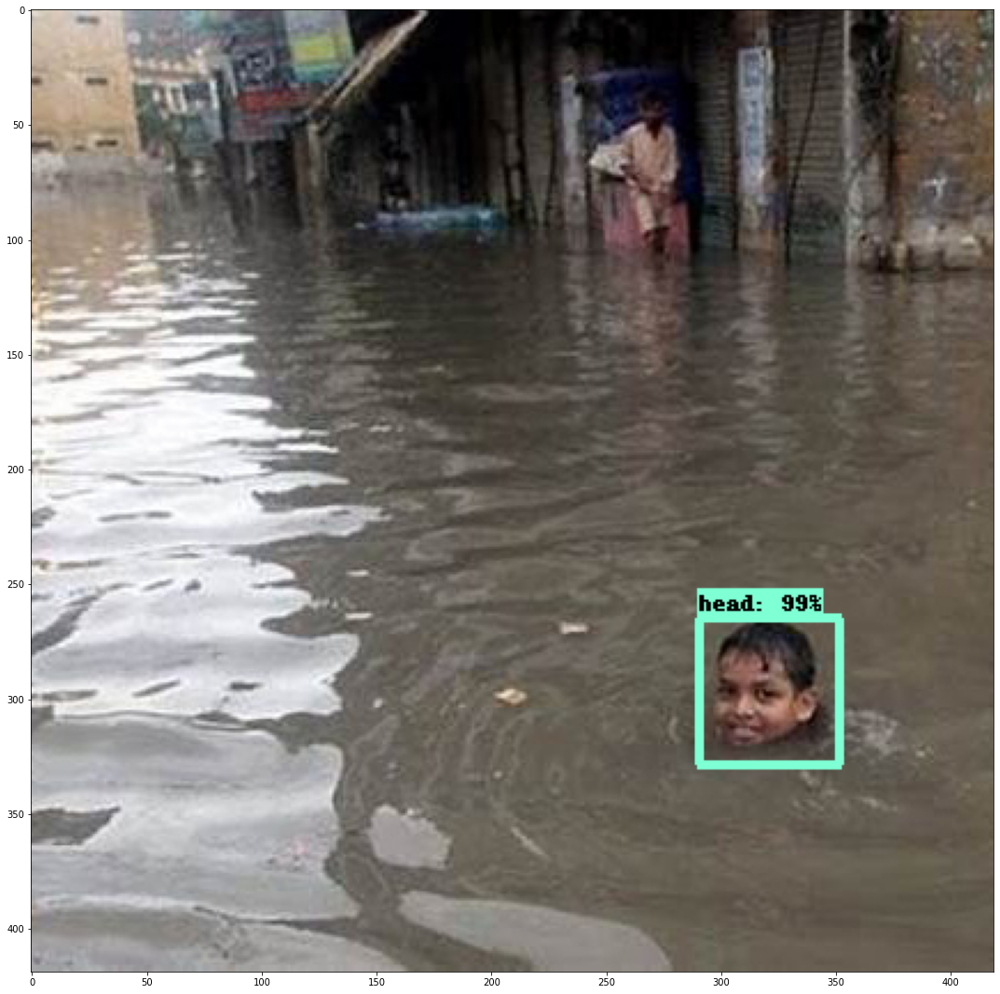

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (6).jpg to uji (6).jpg
saved file uji (6).jpg
/content/drive/MyDrive/models/research
Loading model...Done! Took 12.945737600326538 seconds
Done


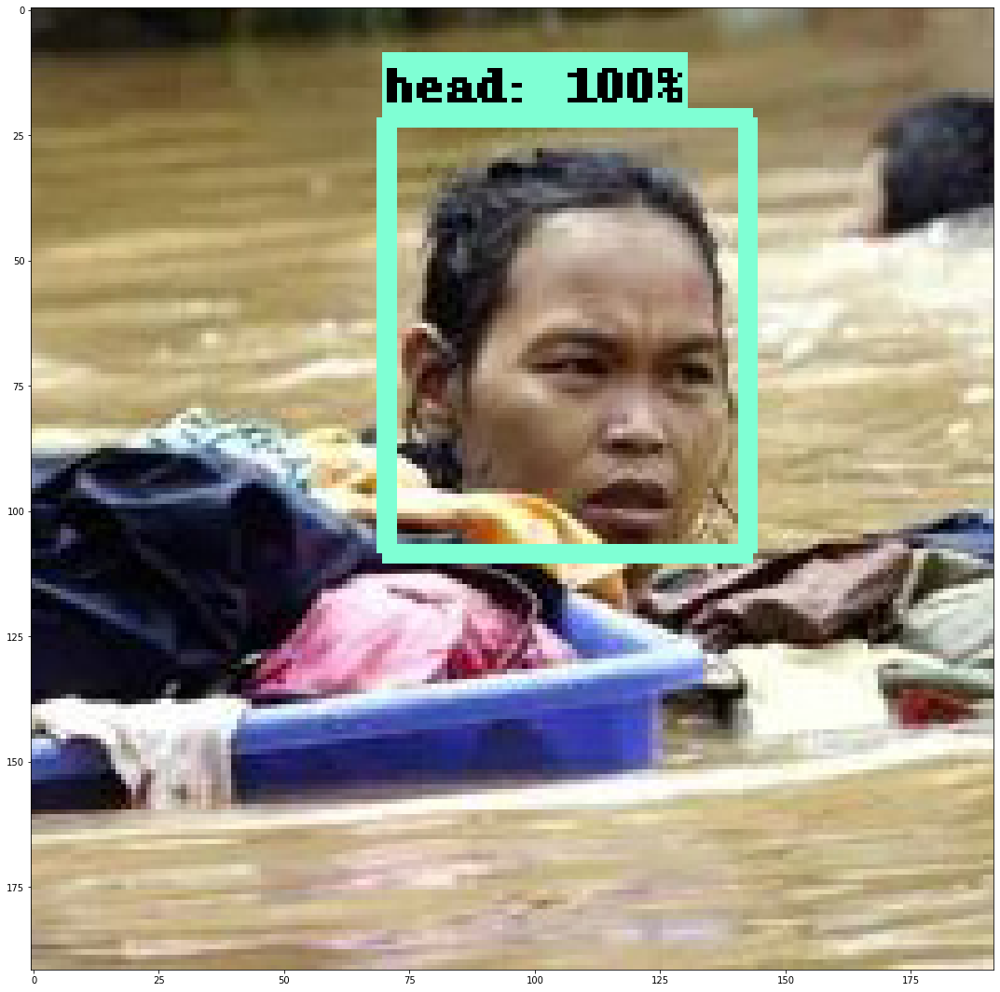

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (16).JPG to uji (16).JPG
saved file uji (16).JPG
/content/drive/MyDrive/models/research
Loading model...Done! Took 12.413224935531616 seconds
Done


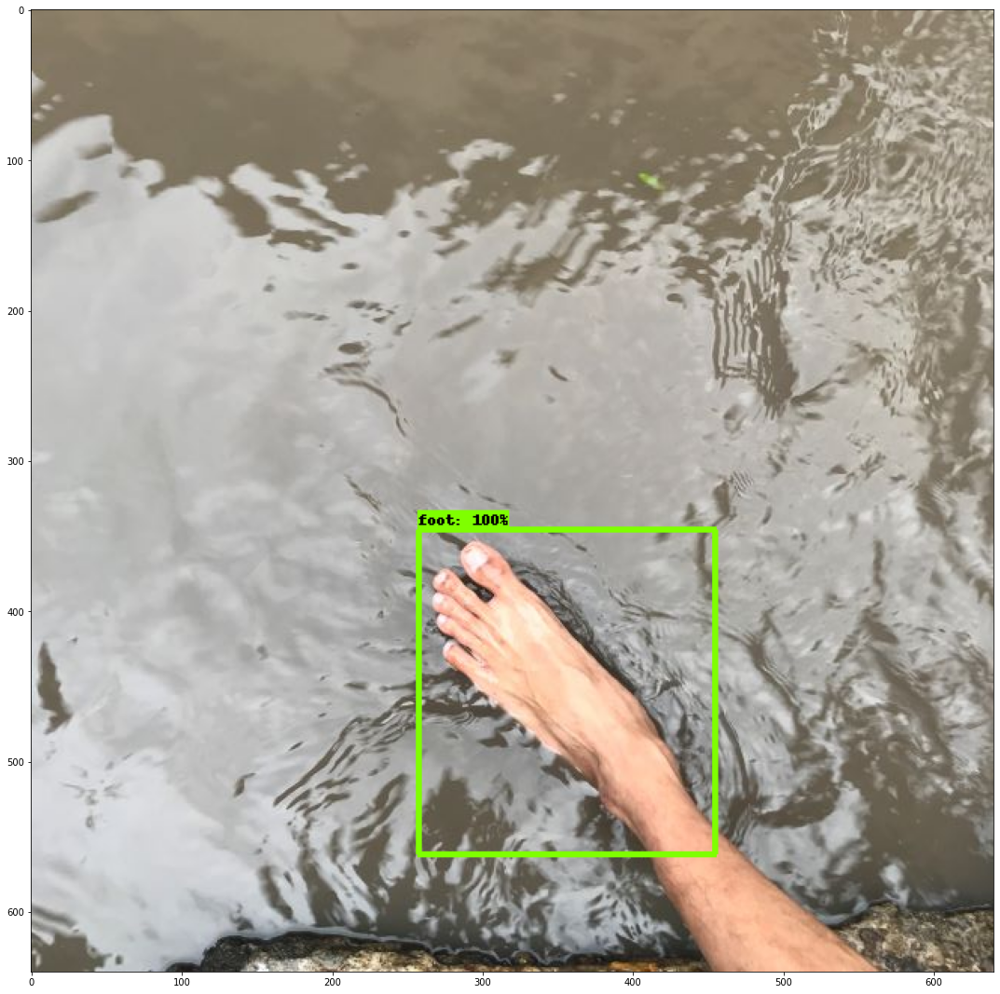

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (8).jpg to uji (8).jpg
saved file uji (8).jpg
/content/drive/MyDrive/models/research
Loading model...Done! Took 13.593115091323853 seconds
Done


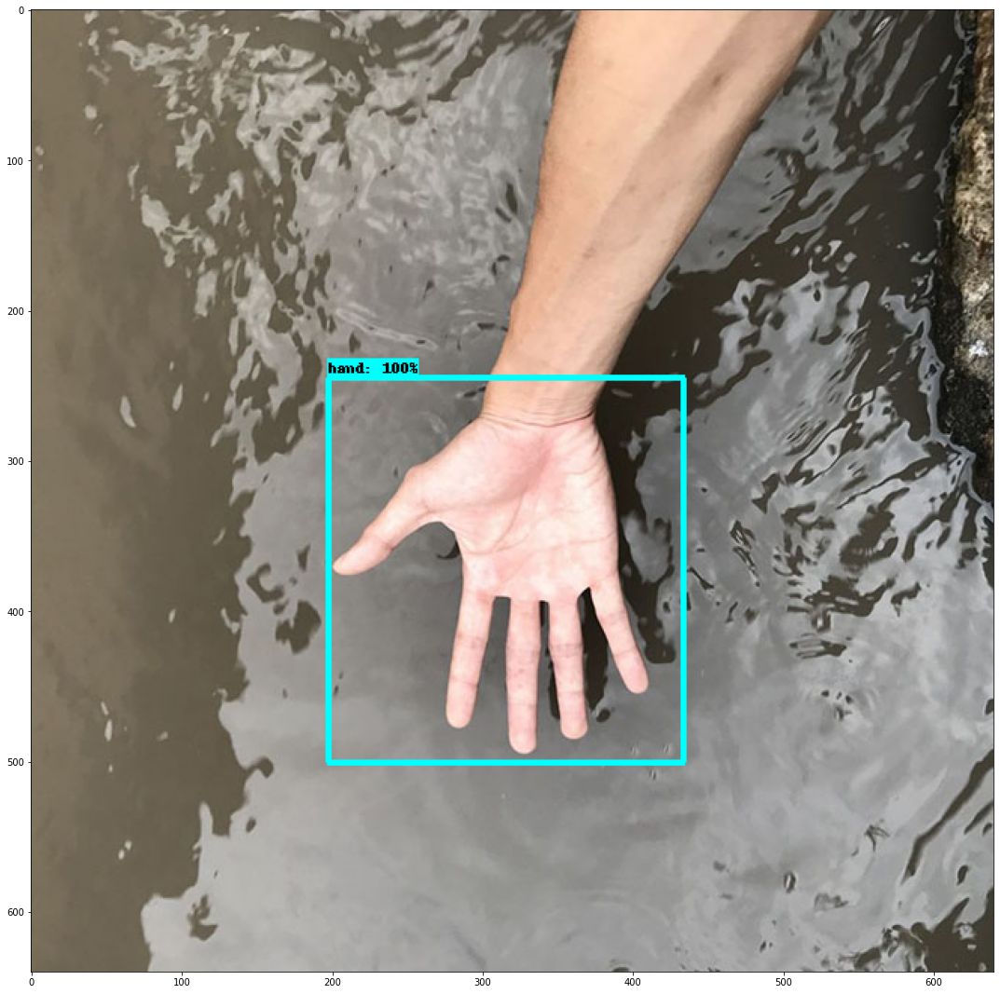

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (9).jpg to uji (9).jpg
saved file uji (9).jpg
/content/drive/MyDrive/models/research
Loading model...Done! Took 13.327391624450684 seconds
Done


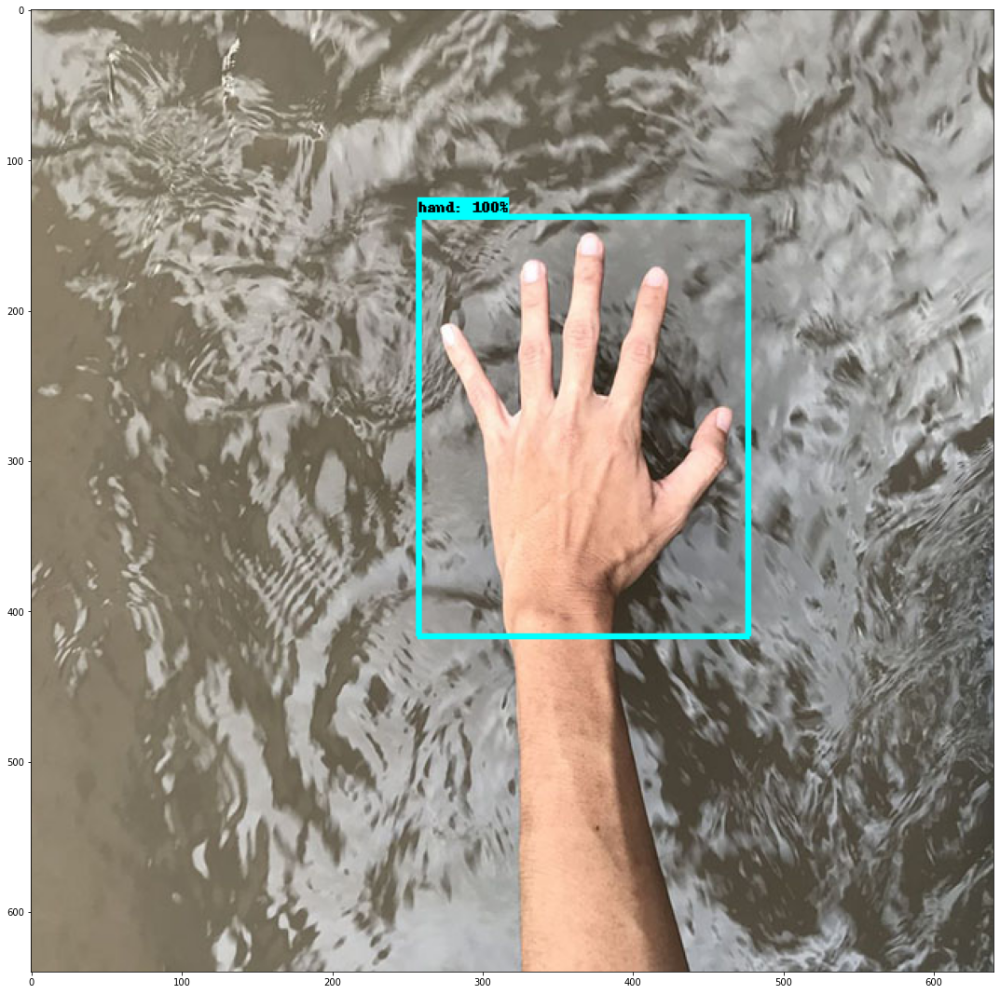

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (14).JPG to uji (14).JPG
saved file uji (14).JPG
/content/drive/MyDrive/models/research
Loading model...Done! Took 13.431077480316162 seconds
Done


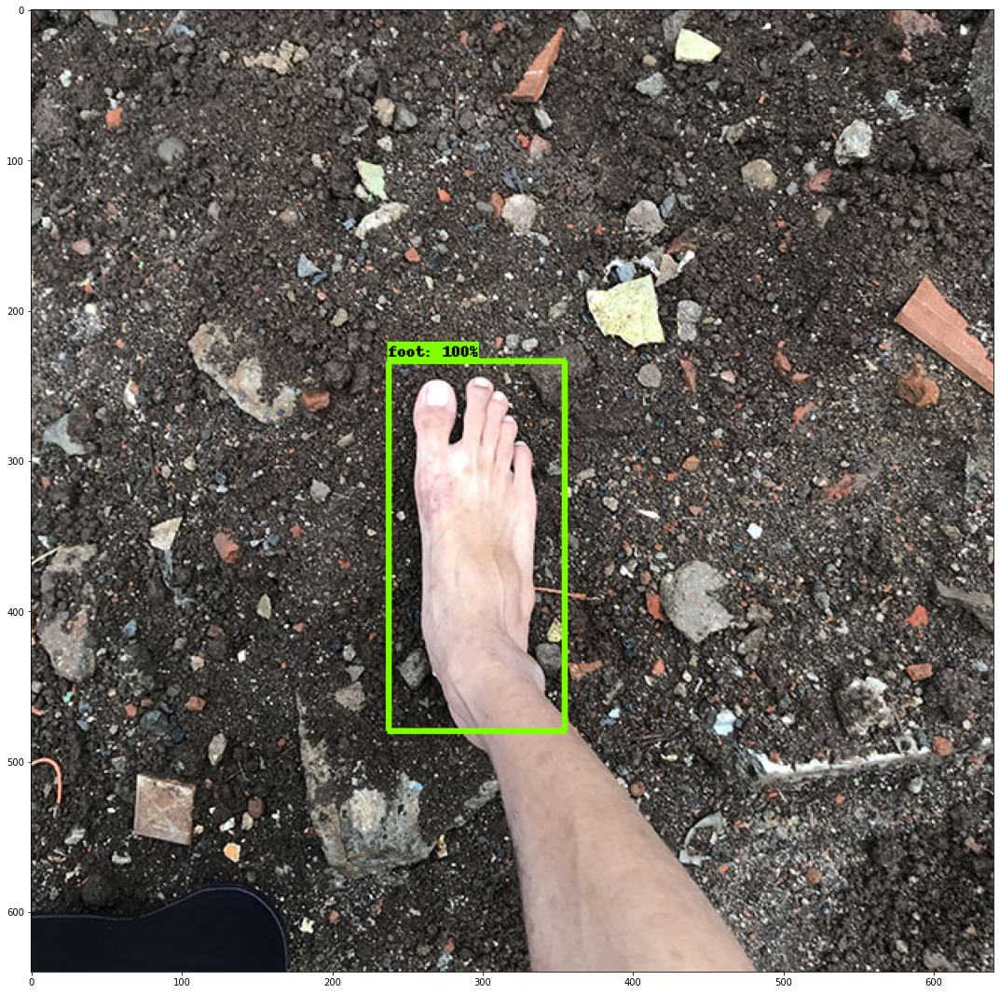

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')

/content/drive/MyDrive/FasterRCNN101/uploaded_image


Saving uji (17).JPG to uji (17).JPG
saved file uji (17).JPG
/content/drive/MyDrive/models/research
Loading model...Done! Took 13.812802076339722 seconds
Done


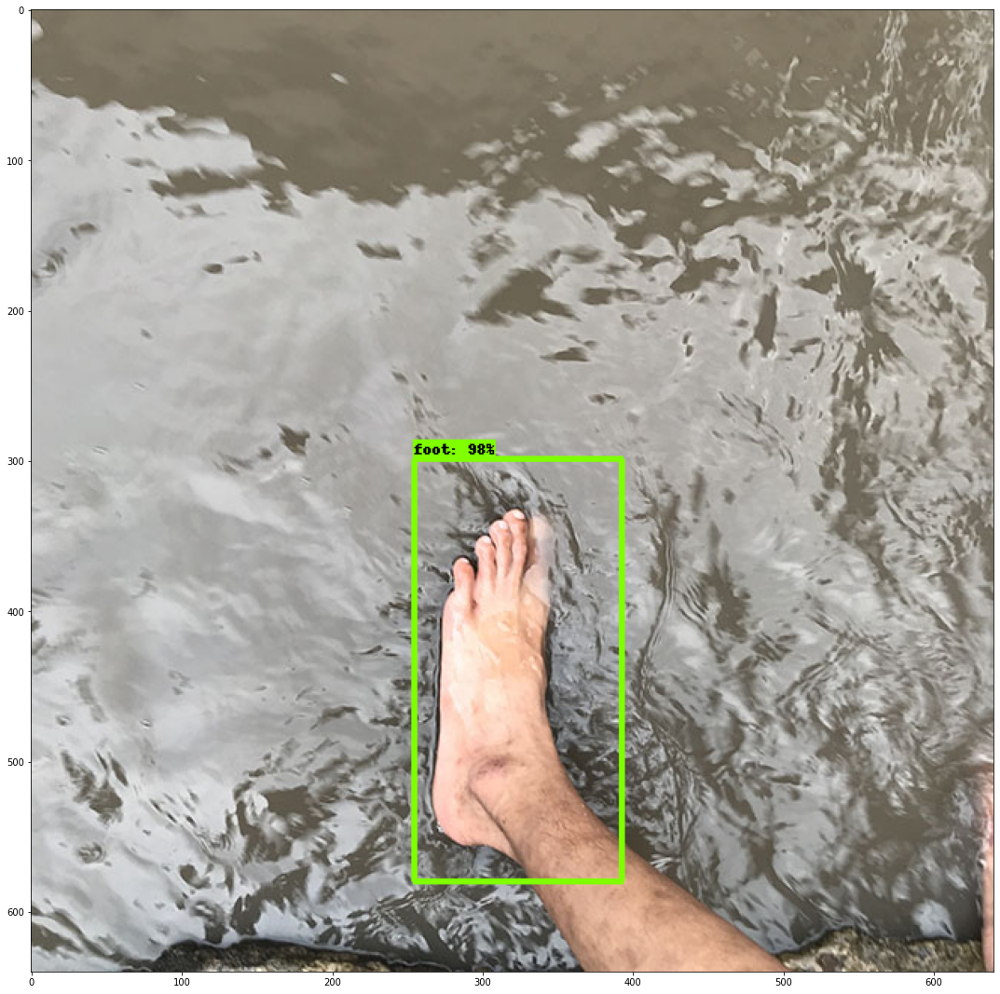

/content/drive/MyDrive/_Artikel/foto_uji_4000
Image saved


In [ ]:
%cd /content/drive/MyDrive/FasterRCNN101/uploaded_image
            
from google.colab import files
from os import path

uploaded = files.upload()
  
for name, data in uploaded.items():
  with open('_uploaded.jpg', 'wb') as f:
    f.write(data)
    f.close()
    print('saved file ' + name)

#Proses deteksi
%cd /content/drive/MyDrive/models/research

#Import the required libraries for Object detection infernece
import time
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime #import save img
import pytz #import save img
%matplotlib inline

# setting min confidence threshold
MIN_CONF_THRESH=.70

#Loading the exported model from saved_model directory
PATH_TO_MODEL_DIR ='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/exported_models/my_models'
print('Loading model...', end='')
start_time = time.time()


# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
PATH_TO_SAVED_MODEL = PATH_TO_MODEL_DIR + "/saved_model"
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

# LOAD LABEL MAP DATA
PATH_TO_LABELS='/content/drive/MyDrive/FasterRCNN101/_Percobaan01/4000/annotations/label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


# LOAD LABEL MAP DATA FOR PLOTTING
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS,
                                                                    use_display_name=True)


#Image file for inference
IMAGE_PATH='/content/drive/MyDrive/FasterRCNN101/uploaded_image/_uploaded.jpg'
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array of shape (height, width, channels), where channels=3 for RGB to feed into tensorflow graph.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB))

# Size, in inches, of the output images.
IMAGE_SIZE = (30, 19)

image_np = load_image_into_numpy_array(IMAGE_PATH)
# Running the infernce on the image specified in the  image path
# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image_np)

# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]
detections = detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy()
               for key, value in detections.items()}
detections['num_detections'] = num_detections
# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
#print(detections['detection_classes'])
image_np_with_detections = image_np.copy()
viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'],
      detections['detection_classes'],
      detections['detection_scores'],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=2,
      min_score_thresh=MIN_CONF_THRESH,
      #min_score_thresh=.30,
      agnostic_mode=False)

#perintah save img
IST = pytz.timezone('Asia/Jakarta')
current_timestamp = datetime.now(IST).strftime('%a-%d%b%y-%H%M%S')
new_name = current_timestamp+'.png'

plt.figure(figsize=IMAGE_SIZE)
plt.imshow(image_np_with_detections)
print('Done')
plt.show()

#menyimpan hasil test
%cd /content/drive/MyDrive/_Artikel/foto_uji_4000
plt.imsave(new_name,image_np_with_detections)
print('Image saved')